Данный проект посвящен анализу поведения клиентов

Для начала возьмем данные с Kaggle (https://www.kaggle.com/datasets/mmohaiminulislam/ecommerce-data-analysis) при помощи Kaggle API

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from statsmodels.tsa.stattools import acf
import plotly.graph_objects as go


In [ ]:
# Указываем директорию для скачивания
local_path = r"C:\Users\serge\OneDrive\Рабочий стол\ML\E-commerce project"
os.makedirs(local_path, exist_ok=True)  # Создаём папку, если её нет

# Скачиваем датасет через Kaggle API
!kaggle datasets download -d mmohaiminulislam/ecommerce-data-analysis -p "{local_path}" --unzip



Dataset URL: https://www.kaggle.com/datasets/mmohaiminulislam/ecommerce-data-analysis
License(s): MIT




  0%|          | 0.00/16.8M [00:00<?, ?B/s]
  6%|▌         | 1.00M/16.8M [00:00<00:09, 1.74MB/s]
 18%|█▊        | 3.00M/16.8M [00:00<00:02, 5.02MB/s]
 36%|███▌      | 6.00M/16.8M [00:00<00:01, 9.50MB/s]
 48%|████▊     | 8.00M/16.8M [00:01<00:00, 11.4MB/s]
 59%|█████▉    | 10.0M/16.8M [00:01<00:00, 13.3MB/s]
 71%|███████▏  | 12.0M/16.8M [00:01<00:00, 14.5MB/s]
 83%|████████▎ | 14.0M/16.8M [00:01<00:00, 15.5MB/s]
 95%|█████████▌| 16.0M/16.8M [00:01<00:00, 15.9MB/s]
100%|██████████| 16.8M/16.8M [00:01<00:00, 11.3MB/s]


Для начала поясним столбцы датафреймов

fact_table.csv

- payment_key - идентификатор, представляющий платёжную транзакцию. Этот ключ ссылается на таблицу Trans_dim.csv
- customer_id - идентификатор, представляющий клиента. Этот ключ ссылается на таблицу customer_dim.csv
- time_key - идентификатор, представляющий временное измерение. Этот ключ связан с таблицей time_dim.csv
- store_key - идентификатор, представляющий магазин или место. Этот ключ ссылается на таблицу store_dim.csv
- quantity - количество проданных или участвующих в транзакции товаров. Представляет объем товаров, связанных с транзакцией
- unit - единица измерения количества. Определяет, в каких единицах измеряется количество товара
- unit_price - цена за единицу товара. 
- total_price - общая стоимость транзакции, рассчитываемая как произведение количества товаров и цены за единицу


cutomer_dim.csv (таблица клиентов)

- customer_key - идентификатор, представляющий уникального клиента. Служит для связи с таблицей fact_table.csv
- name - имя клиента
- contact_no - контактный номер телефона
- nid - национальный идентификационный номер (NID) или уникальный идентификатор клиента

item_dim.csv (таблица товаров)

- item_key - идентификатор, представляющий уникальный товар или продукт. Служит в качестве первичного ключа для связи с fact_table.csv
- item_name - название товара
- desc - описание товара
- unit_price - цена за единицу товара
- man_country - страна, в которой был произведен товар
- supplier - поставщик товара
- unit - единица измерения товара

store_dim.csv (таблица магазинов)

- store_key - идентификатор, представляющий уникальный магазин. Служит в качестве первичного ключа для связи с таблицей fact_table.csv
- division - административный регион или область, где расположен магазин
- district - район, в котором находится магазин
- upazila - упазила (субрайон) или административная единица более низкого уровня, где расположен магазин.

time_dim.csv (таблица времени)

- time_key - Идентификатор, представляющий уникальное время или временную метку. Служит в качестве первичного ключа для связи с fact_table.csv
- date - конкретная дата, связанная с временной меткой
- hour - часовой компонент временной метки
- day - день недели, связанный с временной меткой
- week - номер недели, связанный с временной меткой
- month - месяц, связанный с временной меткой
- quarter - квартал года, связанный с временной меткой
- year - календарный год, связанный с временной меткой

Trans_dim.csv (таблица платежей)

- payment_key - идентификатор, представляющий уникальную платежную транзакцию. Служит в качестве первичного ключа для связи с таблицей fact_table.csv
- trans_type - тип или метод оплаты, использованный в транзакции
- bank_name - название банка, связанного с платежной транзакцией

---

Теперь загрузим все файлы и объединим их

In [4]:
data_path = r"data"

fact_df = pd.read_csv('data/fact_table.csv')
customer_df = pd.read_csv('data/customer_dim.csv', encoding='ISO-8859-1')
item_df = pd.read_csv('data/item_dim.csv', encoding='ISO-8859-1')
store_df = pd.read_csv('data/store_dim.csv')
time_df = pd.read_csv('data/time_dim.csv')
trans_df = pd.read_csv('data/Trans_dim.csv')



In [ ]:

print("Размерность данных:")
print(f"fact_table: {fact_df.shape}")
print(f"customer_dim: {customer_df.shape}")
print(f"item_dim: {item_df.shape}")
print(f"store_dim: {store_df.shape}")
print(f"time_dim: {time_df.shape}")
print(f"trans_dim: {trans_df.shape}")

print("\nПропущенные значения:")
print(fact_df.isnull().sum())


Размерность данных:
fact_table: (1000000, 9)
customer_dim: (9191, 4)
item_dim: (264, 7)
store_dim: (726, 4)
time_dim: (99999, 8)
trans_dim: (39, 3)

Пропущенные значения:
payment_key         0
coustomer_key       0
time_key            0
item_key            0
store_key           0
quantity            0
unit             3723
unit_price          0
total_price         0
dtype: int64


In [ ]:
df = fact_df \
    .merge(customer_df, on="coustomer_key", how="left") \
    .merge(item_df, on="item_key", how="left") \
    .merge(store_df, on="store_key", how="left") \
    .merge(time_df, on="time_key", how="left") \
    .merge(trans_df, on="payment_key", how="left")

In [3]:
df = pd.read_csv('E-commerce_data.csv')

In [3]:
df.head()

,quantity,unit,unit_price,total_price,name,contact_no,nid,item_name,desc,man_country,...,hour,day,week,month,quarter,year,trans_type,bank_name,weekday,average_check
0,1,ct,35.0,35.0,priya,8801529462805,4543429591184,M&M Peanut Candy 1.7 oz,Food - Chocolate,Netherlands,...,17,26,4th Week,4,Q2,2016,card,Premier Bank Limited,Tuesday,35.0
1,1,rolls,26.0,26.0,harpreet kaur,8801985295010,9673146002795,Charmin Ultra Bath Tissue,Kitchen Supplies,Bangladesh,...,19,11,2nd Week,6,Q2,2018,card,NRB Commercial Bank Ltd,Monday,26.0
2,8,ct,12.5,100.0,sonam,8801955748165,2335742897063,Dole Fruit in Gel Cups 4.3 oz,Food - Healthy,poland,...,8,19,3rd Week,11,Q4,2016,card,Shimanto Bank Ltd,Saturday,12.5
3,8,ct,14.0,112.0,rekha bai,8801927509185,4943555261118,Paper Bowls 20 oz Ultra Strong,Dishware - Bowls,Bangladesh,...,6,1,1st Week,2,Q1,2020,card,South Bangla Agriculture and Commerce Bank Lim...,Saturday,14.0
4,8,cans,8.0,64.0,mamta devi,8801549045065,3602133066555,Waterloo Sparkling Watermelon 12oz,a. Beverage Sparkling Water,poland,...,2,15,3rd Week,7,Q3,2014,card,Meghna Bank Limited,Tuesday,8.0


----

Для начала избавимся от идентичных колонок

In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 30 columns):
 #   Column         Non-Null Count    Dtype         
---  ------         --------------    -----         
 0   payment_key    1000000 non-null  object        
 1   coustomer_key  1000000 non-null  object        
 2   time_key       1000000 non-null  object        
 3   item_key       1000000 non-null  object        
 4   store_key      1000000 non-null  object        
 5   quantity       1000000 non-null  int64         
 6   unit_x         996277 non-null   object        
 7   unit_price_x   1000000 non-null  float64       
 8   total_price    1000000 non-null  float64       
 9   name           997010 non-null   object        
 10  contact_no     1000000 non-null  int64         
 11  nid            1000000 non-null  int64         
 12  item_name      1000000 non-null  object        
 13  desc           1000000 non-null  object        
 14  unit_price_y   1000000 non-null  fl

In [44]:
print(df[df['unit_x'] == df['unit_y']].shape)
print(df[df['unit_price_x'] == df['unit_price_y']].shape)

(996277, 30)
(1000000, 30)


В этих колонках данные совпадают, поэтому удалим одну из них

In [ ]:
df.drop(columns=["unit_y"], inplace=True) 
df.rename(columns={"unit_x": "unit"}, inplace=True)

df.drop(columns=["unit_price_y"], inplace=True) 
df.rename(columns={"unit_price_x": "unit_price"}, inplace=True)

In [46]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 28 columns):
 #   Column         Non-Null Count    Dtype         
---  ------         --------------    -----         
 0   payment_key    1000000 non-null  object        
 1   coustomer_key  1000000 non-null  object        
 2   time_key       1000000 non-null  object        
 3   item_key       1000000 non-null  object        
 4   store_key      1000000 non-null  object        
 5   quantity       1000000 non-null  int64         
 6   unit           996277 non-null   object        
 7   unit_price     1000000 non-null  float64       
 8   total_price    1000000 non-null  float64       
 9   name           997010 non-null   object        
 10  contact_no     1000000 non-null  int64         
 11  nid            1000000 non-null  int64         
 12  item_name      1000000 non-null  object        
 13  desc           1000000 non-null  object        
 14  man_country    1000000 non-null  ob

---

Теперь проверим данные на пропуски

In [ ]:
missing_cols = df.isnull().sum()
missing_cols = missing_cols[missing_cols > 0]

print(missing_cols)

unit          3723
name          2990
bank_name    25590
dtype: int64


3 колонки имеют пропущенные значения: unit, name, bank_name

---

Перед тем, как что то заполнять, нужно провести первичный анализ и понять, влияют ли пропуски на анализ

In [52]:
df[df['unit'].isnull()]['item_key'].nunique()

1

Видно, что все пропуски в столбце unit имеют один и тот же item_key, следовательно, это один и тот же продукт. Узнаем название продукта

In [55]:
print('Название продукта', *df[df['unit'].isnull()]['item_name'].unique())

Название продукта Frito Bold Flavors Variety


Загуглив, я узнал, что это набор пачек чипсов. 

In [56]:
df['unit'].unique()

array(['ct', 'rolls', 'cans', 'bottles', 'bags', 'oz', 'tubs', 'cartons',
       'lb', 'tins', 'ct.', 'pack', 'pk', 'bars', 'Bags', 'oz.', nan,
       'Ct', 'botlltes'], dtype=object)

Так как это набор, предлагаю заполнить пропущенные значения при помощи pack

In [58]:
df['unit'].fillna('pack', inplace=True)

Теперь перейдем к name - имя клиента

In [60]:
df[df['name'].isnull()]['item_key'].nunique()

264

In [67]:
df[df['name'].isnull()].head()

,payment_key,coustomer_key,time_key,item_key,store_key,quantity,unit,unit_price,total_price,name,...,upazila,date,hour,day,week,month,quarter,year,trans_type,bank_name
68,P010,C006321,T075495,I00256,S00455,8,pack,20.0,160.0,NaN,...,BURICHANG,2014-08-05 23:46:00,23,5,1st Week,8,Q3,2014,card,Dutch-Bangla Bank Limited
136,P030,C001377,T090005,I00253,S00380,5,bags,21.0,105.0,NaN,...,RAJBARI SADAR,2019-10-12 10:37:00,10,12,2nd Week,10,Q4,2019,card,Shimanto Bank Ltd
279,P006,C006321,T078894,I00232,S00221,4,ct,12.0,48.0,NaN,...,MEHERPUR SADAR,2014-08-30 23:30:00,23,30,4th Week,8,Q3,2014,card,Citizens Bank Limited
314,P002,C001377,T058240,I00172,S00462,9,oz,19.0,171.0,NaN,...,COMILLA ADARSHA SADAR,2016-12-29 05:59:00,5,29,4th Week,12,Q4,2016,card,AB Bank Limited
366,P033,C007961,T099969,I00247,S00319,8,oz,15.0,120.0,NaN,...,KISHOREGANJ SADAR,2016-06-22 02:59:00,2,22,4th Week,6,Q2,2016,card,Trust Bank Limited


In [ ]:
df[df["name"].isnull()]["coustomer_key"].value_counts().head(10)

coustomer_key
C006321    144
C007403    124
C004920    123
C001268    122
C006959    122
C004241    119
C004507    117
C001171    115
C001229    115
C004218    113
Name: count, dtype: int64

По ключу клиента не получится заполнить пропущенные значения, так как все name с данными coustomer_key имеют значение Null

In [81]:
df['name'].fillna('Unknown', inplace=True)

Перейдем к bank_name

In [83]:
df[df["bank_name"].isnull()]["trans_type"].value_counts()

trans_type
cash    25590
Name: count, dtype: int64

bank_name отсутствует только у cash, это нормально, потому что наличные платежи не проходят через банк

Так как bank_name пропущен у cash - заполняем No bank

In [ ]:
df.loc[(df["bank_name"].isnull()), "bank_name"] = "No Bank"

----

Теперь не осталось пропущенных значений, можно переходить к более глубокому анализу

Для начала выясним, как изменялись продажи по времени, есть ли сезонность?

In [ ]:
df['month'] = df['date'].dt.to_period("M").astype(str)
monthly_sales = df.groupby("month")["total_price"].sum().reset_index()

fig = px.bar(
    monthly_sales, x="month", y="total_price", 
    title="Продажи по месяцам", 
    labels={"month": "Месяц", "total_price": "Общая выручка"},
    color_discrete_sequence=["cornflowerblue"]
)

fig.update_layout(
    xaxis_title="Месяц",
    yaxis_title="Общая выручка",
    width=900, height=500
)
fig.show()

- На графике продажи держатся на одном уровне, без резких спадов и пиков
- Нет выраженного роста перед определенными месяцами (например, перед праздниками)
- Визуально график довольно стабильный, без повторяющихся волн

Однако, сильное падение наблюдается в января 2021 года ниже 900000. Возможно, это связано с каким либо событием или изменением, влияющем на бизнес.

Проверим статистически

Проверяем автокорреляцию (ACF)

In [ ]:
acf_values = acf(monthly_sales["total_price"], nlags=24)
lags = list(range(25))
fig = go.Figure()
fig.add_trace(go.Scatter(x=lags, y=acf_values, mode='lines+markers', name='ACF'))

fig.update_layout(
    title="Автокорреляция продаж",
    xaxis_title="Лаг",
    yaxis_title="Автокорреляция",
    width=900, height=500
)

fig.show()

График автокорреляции подтверждает, что сезонности в продажах нет. На лаге 0 корреляция равна 1.0. Все остальные лаги близки к 0 и находятся в пределах доверительного интервала. Более того, нет значительных пиков, что указывало бы на годовую сезонность.

Попробуем построить общий тренд продаж при помощи скользящего среднего

In [ ]:
daily_sales = df.groupby("date")["total_price"].sum().reset_index()
daily_sales["rolling_mean"] = daily_sales["total_price"].rolling(window=30).mean()

fig_trend = go.Figure()
fig_trend.add_trace(go.Scatter(x=daily_sales["date"], y=daily_sales["total_price"],
                               mode='lines', name='Продажи по дням',
                               line=dict(color='gray', width=2), opacity=0.3))
fig_trend.add_trace(go.Scatter(x=daily_sales["date"], y=daily_sales["rolling_mean"],
                               mode='lines', name='Скользящее среднее (30 дней)',
                               line=dict(color='darkblue', width=3)))
fig_trend.update_layout(
    title="Тренд продаж с учетом сглаживания",
    xaxis_title="Дата",
    yaxis_title="Общая выручка",
    width=900, height=500,
    legend_title="Легенда"
)

fig_trend.show()

Также не наблюдается никакой динамики

Попробуем оценить продажи по дням недели. Возможно, продажи в выходные отличаются от продаж в будние дни

In [ ]:
sales_by_weekday = df.groupby("weekday")["total_price"].sum().reindex([
    "Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"
])

fig = go.Figure()
fig.add_trace(go.Bar(
    x=sales_by_weekday.index,
    y=sales_by_weekday.values,
    marker_color="lightblue"
))

fig.update_layout(
    title="Продажи по дням недели",
    xaxis_title="День недели",
    yaxis_title="Общая выручка",
    template="plotly_white"
)

fig.show()

Здесь также не видно какой-либо значимой разницы между дня недели

Попробуем определить, какие время суток наиболее активно в продажах

In [ ]:
df["hour"] = df["date"].dt.hour
sales_by_hour = df.groupby("hour")["total_price"].sum()

fig = go.Figure()
fig.add_trace(go.Bar(
    x=sales_by_hour.index,
    y=sales_by_hour.values,
    marker_color="darkred"
))

fig.update_layout(
    title="Продажи по часам суток",
    xaxis_title="Час",
    yaxis_title="Общая выручка",
    template="plotly_white"
)

fig.show()

На графике видно, что выручка остается примерно одинаковой в течение всех часов суток, без резких провалов или пиков

Выводы:
- Продажи стабильны в течение дня и ночи
- Нет четкого пика в определенные часы - значит, клиенты совершают покупки равномерно
- Нет значительных ночных спадов

Проанализируем количество заказов по часам: возможно, сумма продаж примерно одинакова, но ночью покупают меньше товаров, но более дорогие

In [ ]:
quantity_by_hour = df.groupby("hour")["quantity"].sum()

fig = go.Figure()
fig.add_trace(go.Bar(
    x=quantity_by_hour.index,
    y=quantity_by_hour.values,
    marker_color="orange"
))

fig.update_layout(
    title="Количество проданных товаров по часам суток",
    xaxis_title="Час",
    yaxis_title="Общее количество товаров",
    template="plotly_white"
)

fig.show()

Нет, наше предположение неверно

Далее давайте выясним ТОП-10 продаваемых товаров

In [ ]:
top_items = df.groupby("item_name")["quantity"].sum().sort_values(ascending=False).head(20)

fig = go.Figure()
fig.add_trace(go.Bar(
    x=top_items.index,
    y=top_items.values,
    marker_color="salmon"
))

fig.update_layout(
    title="ТОП-20 продаваемых товаров",
    xaxis_title="Товар",
    yaxis_title="Количество продаж",
    template="plotly_white"
)

fig.show()

Интересное наблюдение: практически все товары из топ-10 самых продаваемых являются газировками

Также проведем анализ продаж по категориям товаров

In [ ]:
revenue_by_category = df.groupby("desc")["total_price"].sum().sort_values(ascending=False)

fig = go.Figure()
fig.add_trace(go.Bar(
    x=revenue_by_category.index,
    y=revenue_by_category.values,
    marker_color="seagreen"
))

fig.update_layout(
    title="Выручка по категориям товаров",
    xaxis_title="Категория",
    yaxis_title="Общая выручка",
    template="plotly_white"
)

fig.show()

Выводы:
- Food - Healthy товары приносят больше всего выручки
- Beverage - Energy/Protein на втором месте
- Kitchen Supplies на третьем

Также узнаем, какой способ оплаты клиенты выбирали чаще

In [ ]:
transaction_counts = df["trans_type"].value_counts().reset_index()
transaction_counts.columns = ["trans_type", "count"]

fig = px.bar(
    transaction_counts,
    x="trans_type",
    y="count",
    color="trans_type",
    title="Оборот средств через способ оплаты",
    labels={"trans_type": "Способ оплаты", "count": "Количество транзакций"},
    color_discrete_sequence=px.colors.qualitative.Set2
)

fig.show()

Преобладающее большинство оплат было произведено при помощи банковских карт

In [ ]:
df["average_check"] = df["total_price"] / df["quantity"]

hist_data = df["average_check"].dropna()
fig = go.Figure()
fig.add_trace(go.Histogram(
    x=hist_data,
    nbinsx=60,  
    marker_color="orange",
    opacity=0.75,
    histnorm="probability density"
))

kde_x = np.linspace(hist_data.min(), hist_data.max(), 200)
kde_y = np.histogram(hist_data, bins=50, density=True)[0]
kde_y = np.interp(kde_x, np.histogram(hist_data, bins=50)[1][:-1], kde_y)
fig.add_trace(go.Scatter(
    x=kde_x, y=kde_y,
    mode='lines',
    line=dict(color='red', width=2),
    name='KDE'
))

fig.update_layout(
    title="Распределение среднего чека",
    xaxis_title="Средний чек",
    yaxis_title="Частота",
    template="plotly_white"
)

fig.show()

Распределение среднего чека

In [30]:
print('Средний размер чека равен,', df['average_check'].mean())

Средний размер чека равен, 17.56160175


Динамика среднего чека по месяцам

In [ ]:



monthly_avg_check = df.groupby(df["date"].dt.to_period("M"))["average_check"].mean()

# Создание графика
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=monthly_avg_check.index.astype(str),
    y=monthly_avg_check.values,
    mode="lines+markers",
    marker=dict(color="orange"),
    line=dict(color="orange", width=2),
    name="Средний чек"
))

fig.update_layout(
    title="Динамика среднего чека по месяцам",
    xaxis_title="Месяц",
    yaxis_title="Средний чек",
    template="plotly_white",
    xaxis=dict(tickmode="array", tickvals=monthly_avg_check.index.astype(str))
)

fig.show()


География продаж: где покупают больше всего

In [ ]:


revenue_by_district = df.groupby("district")["total_price"].sum().sort_values(ascending=False)


fig = go.Figure()
fig.add_trace(go.Bar(
    x=revenue_by_district.index,
    y=revenue_by_district.values,
    marker=dict(color=revenue_by_district.values, colorscale="viridis"),
))

fig.update_layout(
    title="Выручка по регионам",
    xaxis_title="Район",
    yaxis_title="Общая выручка",
    template="plotly_white",
    xaxis=dict(tickangle=-90)
)

fig.show()


DHAKA - безусловный лидер по выручке. Это неудивительно, ведь это столица Бангладеша

In [184]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 30 columns):
 #   Column         Non-Null Count    Dtype         
---  ------         --------------    -----         
 0   payment_key    1000000 non-null  object        
 1   coustomer_key  1000000 non-null  object        
 2   time_key       1000000 non-null  object        
 3   item_key       1000000 non-null  object        
 4   store_key      1000000 non-null  object        
 5   quantity       1000000 non-null  int64         
 6   unit           1000000 non-null  object        
 7   unit_price     1000000 non-null  float64       
 8   total_price    1000000 non-null  float64       
 9   name           1000000 non-null  object        
 10  contact_no     1000000 non-null  int64         
 11  nid            1000000 non-null  int64         
 12  item_name      1000000 non-null  object        
 13  desc           1000000 non-null  object        
 14  man_country    1000000 non-null  ob

In [ ]:


revenue_by_country = df.groupby("man_country")["total_price"].sum().sort_values(ascending=False)

# Создание графика
fig = go.Figure()
fig.add_trace(go.Bar(
    x=revenue_by_country.index,
    y=revenue_by_country.values,
    marker=dict(color=revenue_by_country.values, colorscale="blues"),
))

fig.update_layout(
    title="Выручка по странам-производителям товаров",
    xaxis_title="Страна",
    yaxis_title="Общая выручка",
    template="plotly_white",
    xaxis=dict(tickangle=-90)
)

fig.show()

Лидером оказался Бангладеш

In [ ]:



revenue_by_supplier = df.groupby("supplier")["total_price"].sum().sort_values(ascending=False)

# Создание графика
fig = go.Figure()
fig.add_trace(go.Bar(
    x=revenue_by_supplier.index,
    y=revenue_by_supplier.values,
    marker=dict(color=revenue_by_supplier.values, colorscale="blues"),
))

fig.update_layout(
    title="Выручка по поставщикам",
    xaxis_title="Поставщик",
    yaxis_title="Общая выручка",
    template="plotly_white",
    xaxis=dict(tickangle=-90)
)

fig.show()

DENIMACH LTD оказался лидером

In [ ]:


revenue_by_bank = df.groupby("bank_name")["total_price"].sum().sort_values(ascending=False)

fig = go.Figure()
fig.add_trace(go.Bar(
    x=revenue_by_bank.index,
    y=revenue_by_bank.values,
    marker=dict(color=revenue_by_bank.values, colorscale="blues"),
))

fig.update_layout(
    title="Оборот средств через банк",
    xaxis_title="Банк",
    yaxis_title="Объем средств",
    template="plotly_white",
    xaxis=dict(tickangle=-90)
)

fig.show()


----

Теперь перейдем к анализу клиентов

In [141]:
unique_customers = df["coustomer_key"].nunique()
print(f"Всего уникальных клиентов: {unique_customers}")


Всего уникальных клиентов: 9191


Сколько раз каждый клиент делает покупки?

In [ ]:


customer_frequency = df["nid"].value_counts()

# Создание гистограммы
fig = go.Figure()
fig.add_trace(go.Histogram(
    x=customer_frequency,
    nbinsx=50,
    marker_color="blue",
    opacity=0.75,
    histnorm="probability density"
))

import numpy as np
kde_x = np.linspace(customer_frequency.min(), customer_frequency.max(), 200)
kde_y = np.histogram(customer_frequency, bins=50, density=True)[0]
kde_y = np.interp(kde_x, np.histogram(customer_frequency, bins=50)[1][:-1], kde_y)
fig.add_trace(go.Scatter(
    x=kde_x, y=kde_y,
    mode='lines',
    line=dict(color='red', width=2),
    name='KDE'
))

fig.update_layout(
    title="Распределение частоты покупок клиентов",
    xaxis_title="Количество покупок",
    yaxis_title="Количество клиентов",
    template="plotly_white"
)

fig.show()


График распределения частоты покупок имеет нормальное распределение

RFM-анализ (Recency, Frequency, Monetary)

In [ ]:

# Рассчитываем показатели RFM
rfm = df.groupby("coustomer_key").agg({
    "date": lambda x: (df["date"].max() - x.max()).days,  # Recency
    "coustomer_key": "count",  # Frequency
    "total_price": "sum"  # Monetary
})

# Переименуем колонки
rfm.columns = ["Recency", "Frequency", "Monetary"]

# Разделим клиентов на группы
rfm["R_Segment"] = pd.qcut(rfm["Recency"], 4, labels=[4, 3, 2, 1])  # Чем меньше Recency, тем лучше
rfm["F_Segment"] = pd.qcut(rfm["Frequency"], 4, labels=[1, 2, 3, 4])  # Чем больше Frequency, тем лучше
rfm["M_Segment"] = pd.qcut(rfm["Monetary"], 4, labels=[1, 2, 3, 4])  # Чем больше Monetary, тем лучше

# Итоговый RFM-скор
rfm["RFM_Score"] = rfm[["R_Segment", "F_Segment", "M_Segment"]].sum(axis=1)

# Выводим ТОП клиентов
print("ТОП-10 лояльных клиентов:")
print(rfm.sort_values("RFM_Score", ascending=False).head(10))


ТОП-10 лояльных клиентов:
               Recency  Frequency  Monetary R_Segment F_Segment M_Segment  \
coustomer_key                                                               
C001728              5        120  13086.00         4         4         4   
C006866              2        128  12582.00         4         4         4   
C007267              1        124  12986.25         4         4         4   
C004485              6        126  14391.75         4         4         4   
C003827              2        120  12718.25         4         4         4   
C006500              1        125  13557.50         4         4         4   
C002337              5        129  14268.75         4         4         4   
C007284              7        124  13183.50         4         4         4   
C001380              2        121  13240.50         4         4         4   
C007286              1        138  14620.25         4         4         4   

               RFM_Score  
coustomer_key         

Узнаем, где больше всего клиентов

In [ ]:


unique_customers_by_district = df.groupby("district")["nid"].nunique().sort_values(ascending=False)

# Создание графика
fig = go.Figure()
fig.add_trace(go.Bar(
    x=unique_customers_by_district.index,
    y=unique_customers_by_district.values,
    marker=dict(color=unique_customers_by_district.values, colorscale="viridis"),
))

fig.update_layout(
    title="Количество клиентов по регионам",
    xaxis_title="Район",
    yaxis_title="Количество уникальных клиентов",
    template="plotly_white",
    xaxis=dict(tickangle=-90)
)

fig.show()


Больше всего клиентов в DHAKA и CHITTAHONG

In [200]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 30 columns):
 #   Column         Non-Null Count    Dtype         
---  ------         --------------    -----         
 0   payment_key    1000000 non-null  object        
 1   coustomer_key  1000000 non-null  object        
 2   time_key       1000000 non-null  object        
 3   item_key       1000000 non-null  object        
 4   store_key      1000000 non-null  object        
 5   quantity       1000000 non-null  int64         
 6   unit           1000000 non-null  object        
 7   unit_price     1000000 non-null  float64       
 8   total_price    1000000 non-null  float64       
 9   name           1000000 non-null  object        
 10  contact_no     1000000 non-null  int64         
 11  nid            1000000 non-null  int64         
 12  item_name      1000000 non-null  object        
 13  desc           1000000 non-null  object        
 14  man_country    1000000 non-null  ob

In [213]:
top_clients = df.groupby("name", as_index=False).agg(total_spent=("total_price", "sum")).sort_values(by='total_spent', ascending=False)
fig = px.bar(top_clients.head(10), x='name', y='total_spent',
             title='Топ 10 клиентов по сумме затрат')
fig.update_layout(xaxis_title='Имя', yaxis_title='Общая сумма затрат')
fig.show()


In [214]:
top_clients = df.groupby("name", as_index=False).agg(total_spent=("total_price", "sum")).sort_values(by='total_spent', ascending=False)
fig = px.histogram(top_clients, x='total_spent',
             title='Распределение клиентов по сумме затрат')
fig.update_layout(xaxis_title='Total_Spent', yaxis_title='Count')
fig.show()

In [211]:
top_clients

,name,total_spent
0,-,20643.50
1,??0 ??? ?ì,8631.75
2,????,21142.50
3,?????,21085.50
4,????? ??,12288.00
...,...,...
4530,zeba parveen,11094.50
4531,zeenat,11523.00
4532,zenab khan,10292.25
4533,zina kumari,11193.00


Кластеризация клиентов (разделение на группы)

In [ ]:
rfm["Average_Check"] = rfm["Monetary"] / rfm["Frequency"]
rfm["Avg_Items_per_Order"] = df.groupby("coustomer_key")["quantity"].mean()
rfm["Customer_Lifetime"] = (df["date"].max() - df.groupby("coustomer_key")["date"].min()).dt.days


In [167]:
rfm.head()

,Recency,Frequency,Monetary,R_Segment,F_Segment,M_Segment,RFM_Score,Average_Check,Avg_Items_per_Order,Customer_Lifetime
coustomer_key,,,,,,,,,,
C000001,10,82,8344.75,3,1,1,5,101.765244,5.573171,2542
C000002,61,103,11025.50,1,2,2,5,107.043689,6.174757,2520
C000003,81,108,12120.25,1,2,3,6,112.224537,5.972222,2556
C000004,32,118,13337.00,2,4,4,10,113.025424,6.347458,2535
C000005,60,108,10893.25,1,2,2,5,100.863426,6.277778,2558


In [ ]:


X = rfm[["Recency", "Frequency", "Monetary", "Average_Check", "Avg_Items_per_Order", "Customer_Lifetime"]]

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
rfm["Cluster"] = kmeans.fit_predict(X_scaled)

fig = px.scatter_3d(rfm, x="Frequency", y="Monetary", z="Average_Check", color=rfm["Cluster"].astype(str),
                     title="Кластеры клиентов",
                     labels={"Frequency": "Частота покупок", "Monetary": "Сумма покупок", "Average_Check": "Средний чек"},
                     template="plotly_white")
fig.show()


In [ ]:


silhouette = silhouette_score(X_scaled, kmeans.labels_)
print(f"Silhouette Score: {silhouette:.4f}")


Silhouette Score: 0.2007


Если Silhouette Score близок к нулю, это говорит о том, что границы между кластерами размыты

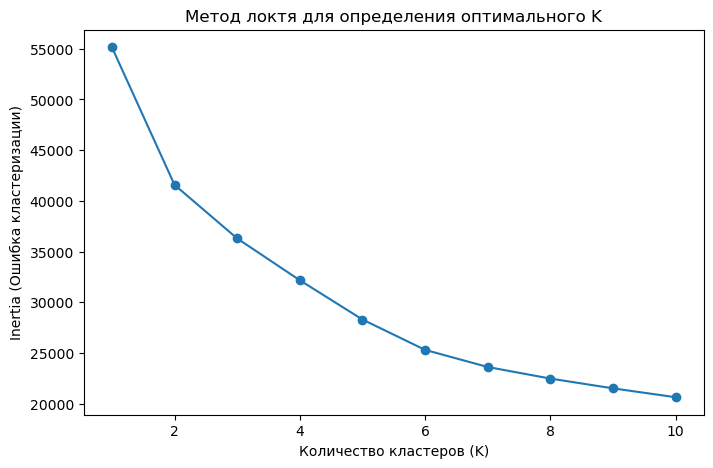

In [ ]:


inertia = []
K_range = range(1, 11)

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)

# Строим график
plt.figure(figsize=(8,5))
plt.plot(K_range, inertia, marker='o', linestyle='-')
plt.xlabel("Количество кластеров (K)")
plt.ylabel("Inertia (Ошибка кластеризации)")
plt.title("Метод локтя для определения оптимального K")
plt.show()


На графике нет четкого изгиба, значит, данные не имеют естественных групп

In [ ]:


pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

df_pca = pd.DataFrame(X_pca, columns=["PCA1", "PCA2"])
df_pca["Cluster"] = kmeans.labels_

fig_pca = px.scatter(df_pca, x="PCA1", y="PCA2", color=df_pca["Cluster"].astype(str),
                     title="PCA-анализ клиентов (есть ли кластеры?)",
                     template="plotly_white")
fig_pca.show()


На графике видно, что кластеры не имеют четких границ. Это говорит о том, что:
- данные распределены плавно, без естественных групп
- кластеры искусственно разделены алгоритмом
- натурального разделения клиентов на группы нет

Попробуем провести кластеризацию на основе плотности (DBSCAN). Если этот алгоритм выдаст один большой кластер, то групп действительно нет

In [ ]:


dbscan = DBSCAN(eps=0.5, min_samples=5)
rfm["Cluster_DBSCAN"] = dbscan.fit_predict(X_scaled)

fig_dbscan = px.scatter(rfm, x="Frequency", y="Monetary", color=rfm["Cluster_DBSCAN"].astype(str),
                        title="DBSCAN Кластеры клиентов",
                        labels={"Frequency": "Частота покупок", "Monetary": "Сумма покупок"},
                        template="plotly_white")
fig_dbscan.show()


График подтверждает, что в данных нет четких кластеров. Значит клиенты распределены постепенно, без явных сегментов

---

Давайте перейдем к визуализации результатов в PowerBI

In [216]:
df = df.drop(['payment_key', 'coustomer_key', 'time_key', 'store_key', 'item_key'], axis=1)

In [219]:
df.to_csv("E-commerce_data.csv", index=False)